 # <h1><center><strong style="color:#ff6161"> Analyzing Road Crash Data </center></strong></h3>


### Part A: You are required to implement various solutions based on RDDs and DataFrames in PySpark for the given queries related to crash data analysis.

## 1. Working with RDD

<h3>1.1 Data Preparation and Loading</h3>

<b> Creating SparkContext object using SparkSession </b>
<p>To run a Spark application on the local/cluster, a few configurations and parameters need to be set, for this, **`SparkConf`** provides configurations to run a Spark application. </p>

In [126]:
# Import SparkConf class into program
from pyspark import SparkConf

# local[*]: runs Spark in local mode with as many working processors as logical cores on your machine
master = "local[*]"
# The appName field is the name shown on the Spark cluster UI page
app_name = "Analyzing Road Crash Data"
# Setup configuration parameters for Spark
spark_conf = SparkConf().setMaster(master).setAppName(app_name)

In [127]:
from pyspark.sql.functions import desc

#Importing Sparkcontext and SparkConf
from pyspark import SparkConf, SparkContext
from pyspark.sql import SparkSession

spark = SparkSession.builder.config(conf=spark_conf).getOrCreate()
sc = spark.sparkContext
sc.setLogLevel('ERROR')



<b>Import all the “Crash” csv files from 2015-2019 into a single RDD, parse each row as a nested list in the RDD, and remove the header rows and display the total count and first 10 records.</b><br>

In [128]:
import csv

#Read csv
crashRDD = sc.textFile("*_Crash.csv")

#Parsing the CSV rdd to CSV Reader 
crashRDD = crashRDD.mapPartitions(lambda x: csv.reader(x))
header = crashRDD.first()
crashRDD = crashRDD.filter(lambda x: x != header)

In [129]:
#Display count of the RDD records. 
crashRDD.count()

72006

In [130]:
#Display the first 10 records of the RDD
crashRDD.take(10)

[['2019-1-8/07/2020',
  '2 Metropolitan',
  'HAMPSTEAD GARDENS',
  '5086',
  'CITY OF PORT ADELAIDE ENFIELD',
  '2',
  '0',
  '0',
  '0',
  '0',
  '2019',
  'June',
  'Wednesday',
  '11:15 am',
  '060',
  'Cross Road',
  'Straight road',
  'Level',
  'Not Applicable',
  'Sealed',
  'Dry',
  'Not Raining',
  'Daylight',
  'Right Angle',
  '01',
  'Driver Rider',
  '1: PDO',
  'Give Way Sign',
  '',
  '',
  '1331810.03',
  '1676603.26',
  '13318101676603'],
 ['2019-2-8/07/2020',
  '2 Metropolitan',
  'DRY CREEK',
  '5094',
  'CITY OF SALISBURY',
  '2',
  '0',
  '0',
  '0',
  '0',
  '2019',
  'January',
  'Tuesday',
  '12:49 am',
  '090',
  'Divided Road',
  'Straight road',
  'Level',
  'Not Applicable',
  'Sealed',
  'Dry',
  'Not Raining',
  'Night',
  'Rear End',
  '02',
  'Driver Rider',
  '1: PDO',
  'No Control',
  '',
  '',
  '1328376.2',
  '1682942.63',
  '13283761682943'],
 ['2019-3-8/07/2020',
  '2 Metropolitan',
  'MILE END',
  '5031',
  'CITY OF WEST TORRENS',
  '2',
  '1',
 

<b>Import all the “Units” csv files from 2015-2019 into a single RDD,  parse each row as a nested list in the
RDD, and remove the header rows and display the total count and first 10 records.</b>

In [131]:
#Read the units CSV's in a rdd
unitsRDD = sc.textFile("*_Units.csv")

#Parsing the CSV rdd to CSV Reader 
unitsRDD = unitsRDD.mapPartitions(lambda x: csv.reader(x))
header = unitsRDD.first()

#Removing the header from each of the files
unitsRDD = unitsRDD.filter(lambda x: x != header)

In [132]:
#Display count of the records in the RDD
unitsRDD.count()

153854

In [133]:
#Display first 10 records
unitsRDD.take(10)

[['2016-1-15/08/2019',
  '01',
  '0',
  'SA',
  'OMNIBUS',
  '2011',
  'North',
  'Male',
  '056',
  'SA',
  'HR',
  'Full',
  'Not Towing',
  'Straight Ahead',
  '010',
  '5121',
  '',
  ''],
 ['2016-1-15/08/2019',
  '02',
  '1',
  '',
  'Pedestrian on Road',
  '',
  'East',
  'Male',
  '072',
  '',
  '',
  '',
  '',
  'Walking on Road',
  '',
  '5084',
  '',
  ''],
 ['2016-2-15/08/2019',
  '01',
  '0',
  'SA',
  'Motor Cars - Sedan',
  '2004',
  'Unknown',
  'Female',
  '023',
  'SA',
  'C ',
  'Full',
  'Not Towing',
  'Straight Ahead',
  '001',
  '5087',
  '',
  ''],
 ['2016-2-15/08/2019',
  '02',
  '0',
  'SA',
  'Station Wagon',
  '2008',
  'Unknown',
  'Male',
  '040',
  'SA',
  'C ',
  'Full',
  'Not Towing',
  'Straight Ahead',
  '001',
  '5084',
  '',
  ''],
 ['2016-3-15/08/2019',
  '01',
  '0',
  'SA',
  'RIGID TRUCK LGE GE 4.5T',
  '1990',
  'South',
  'Unknown',
  'XXX',
  'SA',
  'MR',
  'Provisional 2',
  'Not Towing',
  'Straight Ahead',
  '001',
  '5115',
  '',
  ''],


<h3>1.2 Data Partitioning in RDD</h3>

<b>How many partitions do the above RDDs have?</b>

In [134]:
#Number of default partitions
print("Number of default partitions for crashRDD: {}".format(crashRDD.getNumPartitions()))
print("Number of default partitions for unitsRDD: {}".format(unitsRDD.getNumPartitions()))

Number of default partitions for crashRDD: 5
Number of default partitions for unitsRDD: 5


<b>How is the data in these RDDs partitioned by default, when we do not explicitly specify any partitioning strategy?</b>

In [135]:
print("Default Parallelism is set to :")
sc.defaultParallelism

Default Parallelism is set to :


2

 <p><strong style="color:#2a52be"> As seen the default parallelism is set to 2. And while reading file from a TextFile it is known that the partition size is set to the greater of the two values i.e. the sc.defaultParallelism or number of file blocks, whichever is greater. Therefore, even when no partitioning strategy is defined, RDDs are partitioned in this manner.
<p>
As we can see that the rdd has 5 file blocks which is greater than the default parallelism value set to 2. The default partition size here is equal to 5. Hence, as seen the RDD is partitioned to 5 different blocks. </strong>

In [136]:
crashRDD.glom().collect()

[[['REPORT_ID',
   'Stats Area',
   'Suburb',
   'Postcode',
   'LGA Name',
   'Total Units',
   'Total Cas',
   'Total Fats',
   'Total SI',
   'Total MI',
   'Year',
   'Month',
   'Day',
   'Time',
   'Area Speed',
   'Position Type',
   'Horizontal Align',
   'Vertical Align',
   'Other Feat',
   'Road Surface',
   'Moisture Cond',
   'Weather Cond',
   'DayNight',
   'Crash Type',
   'Unit Resp',
   'Entity Code',
   'CSEF Severity',
   'Traffic Ctrls',
   'DUI Involved',
   'Drugs Involved',
   'ACCLOC_X',
   'ACCLOC_Y',
   'UNIQUE_LOC'],
  ['2019-1-8/07/2020',
   '2 Metropolitan',
   'HAMPSTEAD GARDENS',
   '5086',
   'CITY OF PORT ADELAIDE ENFIELD',
   '2',
   '0',
   '0',
   '0',
   '0',
   '2019',
   'June',
   'Wednesday',
   '11:15 am',
   '060',
   'Cross Road',
   'Straight road',
   'Level',
   'Not Applicable',
   'Sealed',
   'Dry',
   'Not Raining',
   'Daylight',
   'Right Angle',
   '01',
   'Driver Rider',
   '1: PDO',
   'Give Way Sign',
   '',
   '',
   '1331810.

In [137]:
unitsRDD.glom().collect()

[[['2016-1-15/08/2019',
   '01',
   '0',
   'SA',
   'OMNIBUS',
   '2011',
   'North',
   'Male',
   '056',
   'SA',
   'HR',
   'Full',
   'Not Towing',
   'Straight Ahead',
   '010',
   '5121',
   '',
   ''],
  ['2016-1-15/08/2019',
   '02',
   '1',
   '',
   'Pedestrian on Road',
   '',
   'East',
   'Male',
   '072',
   '',
   '',
   '',
   '',
   'Walking on Road',
   '',
   '5084',
   '',
   ''],
  ['2016-2-15/08/2019',
   '01',
   '0',
   'SA',
   'Motor Cars - Sedan',
   '2004',
   'Unknown',
   'Female',
   '023',
   'SA',
   'C ',
   'Full',
   'Not Towing',
   'Straight Ahead',
   '001',
   '5087',
   '',
   ''],
  ['2016-2-15/08/2019',
   '02',
   '0',
   'SA',
   'Station Wagon',
   '2008',
   'Unknown',
   'Male',
   '040',
   'SA',
   'C ',
   'Full',
   'Not Towing',
   'Straight Ahead',
   '001',
   '5084',
   '',
   ''],
  ['2016-3-15/08/2019',
   '01',
   '0',
   'SA',
   'RIGID TRUCK LGE GE 4.5T',
   '1990',
   'South',
   'Unknown',
   'XXX',
   'SA',
   'MR',
   '

#### 2. In the “Units” csv dataset, there is a column called Lic State which shows the state where the vehicle is registered. Assume we want to keep all the data related to SA in one partition and the rest of the data in another partition.

#### a. Create a Key Value Pair RDD with Lic State as the key and rest of the other columns as value.

In [138]:
#Creating a key value pair for Lic State and the remaining fields of the data. 

rdd = unitsRDD.map(lambda x: (x[9], (x[0:9]+x[10:])))
rdd.take(3)

[('SA',
  ['2016-1-15/08/2019',
   '01',
   '0',
   'SA',
   'OMNIBUS',
   '2011',
   'North',
   'Male',
   '056',
   'HR',
   'Full',
   'Not Towing',
   'Straight Ahead',
   '010',
   '5121',
   '',
   '']),
 ('',
  ['2016-1-15/08/2019',
   '02',
   '1',
   '',
   'Pedestrian on Road',
   '',
   'East',
   'Male',
   '072',
   '',
   '',
   '',
   'Walking on Road',
   '',
   '5084',
   '',
   '']),
 ('SA',
  ['2016-2-15/08/2019',
   '01',
   '0',
   'SA',
   'Motor Cars - Sedan',
   '2004',
   'Unknown',
   'Female',
   '023',
   'C ',
   'Full',
   'Not Towing',
   'Straight Ahead',
   '001',
   '5087',
   '',
   ''])]

#### b. Write the code to implement this partitioning in RDD using appropriate partitioning functions.

In [139]:
from pyspark.rdd import RDD

#A Function to print the data items in each RDD
#Same function is used to print out the data items of a DataFrame later
def print_partitions(data):
    if isinstance(data, RDD):
        numPartitions = data.getNumPartitions()
        partitions = data.glom().collect()
    else:
        numPartitions = data.rdd.getNumPartitions()
        partitions = data.rdd.glom().collect()
    
    print(f"####### NUMBER OF PARTITIONS: {numPartitions}")
    for index, partition in enumerate(partitions):
        # show partition if it is not empty
        if len(partition) > 0:
            print(f"Partition {index}: {len(partition)} records")
            #print(partition)

#### Hash Function determining the partioning for only records with SA to be included in one of the partition and the remaining in other.

In [140]:
def hash_function(key):
#Defining the key as SA. 
    total = 0
    if key == 'SA':
        total = 0
    else:
        total = 1
    return total

#### To resolve the iopub limit error. You should start the Jupyter session wih the following additional settings: 

### jupyter notebook --NotebookApp.iopub_data_rate_limit=1.0e10


In [141]:
hash_partitioned_rdd = rdd.partitionBy(2, hash_function)
print_partitions(hash_partitioned_rdd)

####### NUMBER OF PARTITIONS: 2
Partition 0: 109684 records
Partition 1: 44170 records


#### <p><strong style="color:#2a52be">	As seen the data is partitoned with 109684 records in one of the partitions. The other partition only ends with 44170 records. This is definitely a case of data skewness. And heavy load on one of the partioners.
<p> <strong style="color:#2a52be">
<p> Advantages for this partition:
<p> Faster key operations like reduceByKey
<p> Optimize performance and achieves parallelism!

In [142]:
print("Number of partitions: {}".format(hash_partitioned_rdd.getNumPartitions()))
print("Partitioner: {}".format(hash_partitioned_rdd.partitioner))
print("Partitions structure: {}".format(hash_partitioned_rdd.glom().collect()))

Number of partitions: 2
Partitioner: <pyspark.rdd.Partitioner object at 0x7f5a173c9850>
Partitions structure: [[('SA', ['2016-1-15/08/2019', '01', '0', 'SA', 'OMNIBUS', '2011', 'North', 'Male', '056', 'HR', 'Full', 'Not Towing', 'Straight Ahead', '010', '5121', '', '']), ('SA', ['2016-2-15/08/2019', '01', '0', 'SA', 'Motor Cars - Sedan', '2004', 'Unknown', 'Female', '023', 'C ', 'Full', 'Not Towing', 'Straight Ahead', '001', '5087', '', '']), ('SA', ['2016-2-15/08/2019', '02', '0', 'SA', 'Station Wagon', '2008', 'Unknown', 'Male', '040', 'C ', 'Full', 'Not Towing', 'Straight Ahead', '001', '5084', '', '']), ('SA', ['2016-3-15/08/2019', '01', '0', 'SA', 'RIGID TRUCK LGE GE 4.5T', '1990', 'South', 'Unknown', 'XXX', 'MR', 'Provisional 2', 'Not Towing', 'Straight Ahead', '001', '5115', '', '']), ('SA', ['2016-3-15/08/2019', '02', '0', 'SA', 'Panel Van', '2013', 'South', 'Male', '023', 'C ', 'Full', 'Not Towing', 'Straight Ahead', '001', '5110', '', '']), ('SA', ['2016-4-15/08/2019', '01', 

<b>1.3 Query/Analysis</b>

# <b>1. Find the average age of male and female drivers separately.</b>

In [143]:
#Build key value pair rdd for gender and age. With Gender as the key and age as the value. 
unit_gender = unitsRDD.map(lambda el: (el[7],el[8]))

# Filtering the data which inludes empty , Unknown in the Gender column , XXX characters in the Age values data.
rdd_clean = unit_gender.filter(lambda x: x[0] != "").filter(lambda x: x[0] != 'Unknown').filter(lambda x: x[1] != 'XXX')

#Converting the age field to int as it is in a string format.
rdd_clean = rdd_clean.map(lambda x: (x[0], int(x[1])))

In [144]:
#Create a key value pair of (Gender,(Age, 1)) using mapValues (mapValues only work with the values of the key). 
#reduceByKey combines all the Male pairs together, sums the age and sums the count
#The result generated is a key-value pair, (gender, (Sum of age, Number of people belonging to the same gender))
totalByGender = rdd_clean.mapValues(lambda x : (x,1)).reduceByKey(lambda x,y: (x[0]+ y[0],x[1]+ y[1]))
totalByGender.collect()


[('Male', (3022100, 73753)), ('Female', (1901878, 47091))]

In [145]:
#Calculate Average Age = Sum of age / Number of people belonging to that gender
averageByAge = totalByGender.mapValues(lambda x: round(x[0]/x[1],2))
averageByAge.collect()
print("The average age for both Male and Female can be seen as: ")
for xs in averageByAge.take(100):
    print(xs)

The average age for both Male and Female can be seen as: 
('Male', 40.98)
('Female', 40.39)


### <p><strong style="color:#2a52be"> The average age for Male is 40.98 approximately equal to 41. And the average age for Female is 40.39. </strong>

<b>2. What is the oldest and the newest vehicle year involved in the accident? Display the
Registration State, Year and Unit type of the vehicle.</b>


In [146]:
#Creating a key value pair with Year as the key and Registration State and Unit Type as the values.
vehYearKeyPair = unitsRDD.map(lambda el: (el[5],(el[3],el[4])))

In [147]:
#Filtering the data with removing fields which include empty or 'XXXX' in the Year field.
vehicleYearRDD = vehYearKeyPair.filter(lambda x: x[0] != '')
vehicleYearRDD = vehicleYearRDD.filter(lambda x: x[0] != 'XXXX')


In [148]:
# Converting the year to int to find the Max and min for the Year
rdd_clean = vehicleYearRDD.map(lambda el: (int(el[0]),(el[1][0],el[1][1])))

In [149]:
#Finding the newest year from the data 
rdd_clean.max(key=lambda x:x[0])

(2019, ('SA', 'Station Wagon'))

 ### <p><strong style="color:#2a52be"> The newest vehicle year involved in the accident is 2019. </strong>

In [150]:
#Finding the oldest year from the data 
rdd_clean.min(key=lambda x:x[0])

(1900, ('VIC', 'Motor Cycle'))

 ### <p><strong style="color:#2a52be"> The oldest vehicle year involved in the accident is 1900. </strong>

## 2. Working with DataFrames 

### 2.1 Data Preparation and Loading

#### 1. Load all units and crash data into two separate dataframes.

In [151]:
#Reading the Units csv's in a dataframe
unitDF = spark.read.format("csv").option("header", "true").option("inferSchema", "true").load('*_Units.csv')

In [152]:
#Counting the total records in the dataframe
unitDF.count()

153854

In [153]:
#Reading the Crash csv's in a dataframe
crashDF = spark.read.format("csv").option("header", "true").option("inferSchema", "true").load('*_Crash.csv')

In [154]:
#Counting the total records in the dataframe
crashDF.count()

72006

### 2. Display the schema of the final two dataframes.

In [155]:
#Displaying the schema for Units dataframe
unitDF.printSchema()

root
 |-- REPORT_ID: string (nullable = true)
 |-- Unit No: integer (nullable = true)
 |-- No Of Cas: integer (nullable = true)
 |-- Veh Reg State: string (nullable = true)
 |-- Unit Type: string (nullable = true)
 |-- Veh Year: string (nullable = true)
 |-- Direction Of Travel: string (nullable = true)
 |-- Sex: string (nullable = true)
 |-- Age: string (nullable = true)
 |-- Lic State: string (nullable = true)
 |-- Licence Class: string (nullable = true)
 |-- Licence Type: string (nullable = true)
 |-- Towing: string (nullable = true)
 |-- Unit Movement: string (nullable = true)
 |-- Number Occupants: string (nullable = true)
 |-- Postcode: string (nullable = true)
 |-- Rollover: string (nullable = true)
 |-- Fire: string (nullable = true)



In [156]:
#Displaying the schema for Crash dataframe
crashDF.printSchema()

root
 |-- REPORT_ID: string (nullable = true)
 |-- Stats Area: string (nullable = true)
 |-- Suburb: string (nullable = true)
 |-- Postcode: integer (nullable = true)
 |-- LGA Name: string (nullable = true)
 |-- Total Units: integer (nullable = true)
 |-- Total Cas: integer (nullable = true)
 |-- Total Fats: integer (nullable = true)
 |-- Total SI: integer (nullable = true)
 |-- Total MI: integer (nullable = true)
 |-- Year: integer (nullable = true)
 |-- Month: string (nullable = true)
 |-- Day: string (nullable = true)
 |-- Time: string (nullable = true)
 |-- Area Speed: integer (nullable = true)
 |-- Position Type: string (nullable = true)
 |-- Horizontal Align: string (nullable = true)
 |-- Vertical Align: string (nullable = true)
 |-- Other Feat: string (nullable = true)
 |-- Road Surface: string (nullable = true)
 |-- Moisture Cond: string (nullable = true)
 |-- Weather Cond: string (nullable = true)
 |-- DayNight: string (nullable = true)
 |-- Crash Type: string (nullable = true

### 2.2 Query/Analysis (15%)
#### Implement the following queries using dataframes.

#### 1. Find all the crash events in Adelaide where the total number of casualties in the event is more than 3.

In [157]:
#Filtering the Suburb as Adelaide as 
crasheventsjoindf = crashDF.filter(crashDF["Suburb"] == "ADELAIDE")

In [158]:
#Checking for Total No of Casualities greater than 3
crashAdelaide = crasheventsjoindf.filter(crasheventsjoindf["Total Cas"] > 3)

In [159]:
crashAdelaide.select("REPORT_ID","Suburb","Total Cas", "Crash Type", "CSEF Severity").show(truncate = False,  vertical=False)

+---------------------+--------+---------+--------------+-------------+
|REPORT_ID            |Suburb  |Total Cas|Crash Type    |CSEF Severity|
+---------------------+--------+---------+--------------+-------------+
|2018-601-17/01/2020  |ADELAIDE|4        |Hit Pedestrian|3: SI        |
|2017-1613-15/08/2019 |ADELAIDE|4        |Right Turn    |2: MI        |
|2017-12182-15/08/2019|ADELAIDE|5        |Hit Pedestrian|3: SI        |
|2019-10404-8/07/2020 |ADELAIDE|6        |Right Turn    |2: MI        |
+---------------------+--------+---------+--------------+-------------+



In [160]:
#Checking the count for total casualities in Adelaide
crashAdelaideCountFin = crashAdelaide.count()
print("The count crash events in Adelaide where the total number of casualties in the event is more than 3 is :", crashAdelaideCountFin)

The count crash events in Adelaide where the total number of casualties in the event is more than 3 is : 4


#### 2. Display 10 crash events with highest casualties.

In [161]:
#Finding the crash events with highest casualities

#Arranging the Total Casualities field in descending order
topCasDF = crashDF.orderBy('Total Cas', ascending=False)

#Limiting the top 10 records
top10CasDF = topCasDF.limit(10)

#Displaying only the following fields for the top 10 records.
top10CasDF.select("REPORT_ID","Suburb","Total Cas","Crash Type").show(truncate = False, vertical = False)

+---------------------+-------------+---------+-----------+
|REPORT_ID            |Suburb       |Total Cas|Crash Type |
+---------------------+-------------+---------+-----------+
|2017-288-15/08/2019  |PARA HILLS   |11       |Right Angle|
|2016-3035-15/08/2019 |HACKHAM      |9        |Right Turn |
|2016-6630-15/08/2019 |KANGAROO FLAT|9        |Head On    |
|2019-11734-8/07/2020 |STURT        |9        |Right Turn |
|2016-7073-15/08/2019 |MERRITON     |8        |Head On    |
|2016-14407-15/08/2019|STOCKWELL    |8        |Head On    |
|2015-2823-21/08/2019 |HAWKER       |8        |Roll Over  |
|2016-8547-15/08/2019 |WINDSOR      |7        |Rear End   |
|2015-6965-21/08/2019 |BEAUFORT     |7        |Head On    |
|2015-12591-21/08/2019|MALLALA      |7        |Right Angle|
+---------------------+-------------+---------+-----------+



#### 3. Find the total number of fatalities for each crash type.

In [162]:
#Grouping the data with the crash type and renaming the aggregate column 
crashtypeSumDF = crashDF.groupBy("Crash Type").agg({'Total Fats':'sum'}).withColumnRenamed("sum(Total Fats)", "Total No of Fatalities")

#Arranging the grouped data in descending order
crashtypeSumDF.sort(desc('Total No of Fatalities')).show(truncate = False, vertical = False)


+--------------------------+----------------------+
|Crash Type                |Total No of Fatalities|
+--------------------------+----------------------+
|Hit Fixed Object          |152                   |
|Head On                   |86                    |
|Hit Pedestrian            |70                    |
|Roll Over                 |57                    |
|Right Angle               |45                    |
|Side Swipe                |20                    |
|Right Turn                |18                    |
|Rear End                  |16                    |
|Hit Parked Vehicle        |9                     |
|Hit Animal                |4                     |
|Hit Object on Road        |2                     |
|Other                     |2                     |
|Left Road - Out of Control|1                     |
+--------------------------+----------------------+



#### 4. Find the total number of casualties for each suburb when the vehicle was driven by an unlicensed driver. You are required to display the name of the suburb and the total number of casualties.

In [163]:
#Filtering the UnitDF to get only the unlicensed drivers
unitfilterdf = unitDF.filter(unitDF["Licence Type"] == "Unlicenced")

#Optimizing the join the query by selecting only the required columns
unitfilterdf = unitfilterdf.select("REPORT_ID")

In [164]:
#Optimizing the join the query by selecting only the required columns
crashfilterdf = crashDF.select("REPORT_ID","Suburb", "Total Cas")

In [165]:
#Joining the two data frames on REPORT_ID
crashjoindf = crashfilterdf.join(unitfilterdf, crashDF["REPORT_ID"] == unitDF["REPORT_ID"])

In [166]:
#Grouping the filtered data based on Suburbs and displaying the results with the maximum casualities in a suburb shown first
crashjoindf.groupBy("Suburb").agg({'Total Cas':'sum'}).withColumnRenamed("sum(Total Cas)", "Total No of Casualities").sort(desc('Total No of Casualities')).show()


+---------------+-----------------------+
|         Suburb|Total No of Casualities|
+---------------+-----------------------+
|       ADELAIDE|                     19|
|      SALISBURY|                     18|
|      DRY CREEK|                     18|
| SALISBURY EAST|                     16|
|       PROSPECT|                     14|
| NORTH ADELAIDE|                     13|
|        ENFIELD|                     12|
|   ANDREWS FARM|                     12|
|SALISBURY DOWNS|                     11|
|     INGLE FARM|                     11|
|SALISBURY SOUTH|                     11|
|   BEDFORD PARK|                     11|
|   MOUNT BARKER|                     10|
|     MUNNO PARA|                     10|
|SALISBURY PLAIN|                     10|
|         BURTON|                     10|
| ELIZABETH PARK|                     10|
|  MORPHETT VALE|                     10|
|   MAWSON LAKES|                     10|
|    HOLDEN HILL|                      9|
+---------------+-----------------

## 2.3 Severity Analysis

### Using the DataFrame for crash events, implement the following queries:
### 1. Find the total number of crash events for each severity level. Which severity level is the most common?


In [167]:
%%time
#Finding the total count of different CSEF Severity levels in the data  
crashSeverityDF = crashDF.groupBy(crashDF["CSEF Severity"]).count()

#Ordering the data to find the most common level amongst the different levels
crashSeverityDF = crashSeverityDF.orderBy(crashDF ["CSEF Severity"]).show()

+-------------+-----+
|CSEF Severity|count|
+-------------+-----+
|       1: PDO|46696|
|        2: MI|21881|
|        3: SI| 2978|
|     4: Fatal|  451|
+-------------+-----+

CPU times: user 0 ns, sys: 3.95 ms, total: 3.95 ms
Wall time: 1.79 s


### <p><strong style="color:red"> Inference : </strong>  <p><strong style="color:#2a52be"> The lowest level 1: Property Damage Only is the most common severity level amongst the others. </strong>

#### 2. Compute the total number of crash events for each severity level and the percentage for the four different scenarios.

#### a. When the driver is tested positive on drugs.

In [168]:
import pyspark.sql.functions as f
from pyspark.sql.window import Window

SevDrugDF = crashDF.where((f.col("Drugs Involved") =="Y")  & (f.col("DUI Involved").isNull()))

#Grouping the Severity level to count the different severity levels
SevDrugDF = SevDrugDF.groupBy(SevDrugDF["CSEF Severity"]).count().orderBy(SevDrugDF["CSEF Severity"])

#Finding the percentage of each of the different severity levels
SevDrugDF = SevDrugDF.withColumn("Percentage", f.round(f.col('count')/f.sum('count').over(Window.partitionBy())*100, 2))

#Renaming the Count column
SevDrugDF.withColumnRenamed("count", "Total No of Crash Events").orderBy(SevDrugDF["CSEF Severity"]).show()

#Used for combining the results for end Analysis
SevDrugDFT4 = SevDrugDF.withColumnRenamed("Percentage", "On drugs").orderBy(SevDrugDF["CSEF Severity"]).select("CSEF Severity","On drugs")



+-------------+------------------------+----------+
|CSEF Severity|Total No of Crash Events|Percentage|
+-------------+------------------------+----------+
|       1: PDO|                     152|     14.09|
|        2: MI|                     660|     61.17|
|        3: SI|                     212|     19.65|
|     4: Fatal|                      55|       5.1|
+-------------+------------------------+----------+



### <p><strong style="color:red"> Inference : </strong>  <p><strong style="color:#2a52be"> Minor Injuries were seen to be most common when the driver was under the influence of drugs. </strong> 

#### b. When the driver is tested positive for blood alcohol concentration.

In [169]:
#Filtering the Crash data frame to include only drivers who have tested positive for blood alcohol concentration at the time of crash
SevAlcoholDF = crashDF.where((f.col("DUI Involved") =="Y")  & (f.col("Drugs Involved").isNull()))

#SevAlcoholDF = crashDF.filter(crashDF["DUI Involved"] == "Y")
#Grouping the severity levels and counting the instances for it
SevAlcoholDF = SevAlcoholDF.groupBy(SevAlcoholDF["CSEF Severity"]).count().orderBy(SevAlcoholDF["CSEF Severity"])
#Finding the percentage of each of the different severity levels
SevAlcoholDF = SevAlcoholDF.withColumn("Percentage", f.round(f.col('count')/f.sum('count').over(Window.partitionBy())*100, 2))
#Renaming the Count column
SevAlcoholDF.withColumnRenamed("count", "Total No of Crash Events").show()

#Used for combining the results for end Analysis
SevAlcoholDFT4 = SevAlcoholDF.withColumnRenamed("Percentage", "On Alcohol").orderBy(SevAlcoholDF["CSEF Severity"]).select("CSEF Severity","On alcohol")



+-------------+------------------------+----------+
|CSEF Severity|Total No of Crash Events|Percentage|
+-------------+------------------------+----------+
|       1: PDO|                    1149|     55.43|
|        2: MI|                     648|     31.26|
|        3: SI|                     224|     10.81|
|     4: Fatal|                      52|      2.51|
+-------------+------------------------+----------+



### <p><strong style="color:red"> Inference : </strong>  <p><strong style="color:#2a52be">  Property Damages were seen to be most common when the driver was under the influence of alcohol. </strong> 

#### c. When the driver is tested positive for both drugs and blood alcohol. 

In [170]:
#Filtering the Crash data frame to include drivers who have tested positive for both drugs and blood alcohol at the time of crash  
SevBothDF = crashDF.filter((crashDF["Drugs Involved"] == "Y") & (crashDF["DUI Involved"] == "Y"))
#Grouping the severity levels and counting the instances for it
SevBothDF = SevBothDF.groupBy(SevBothDF["CSEF Severity"]).count().orderBy(SevBothDF["CSEF Severity"])
#Finding the percentage of each of the different severity levels
SevBothDF = SevBothDF.withColumn("Percentage", f.round(f.col('count')/f.sum('count').over(Window.partitionBy())*100, 2))
#Renaming the Count column
SevBothDF.withColumnRenamed("count", "Total No of Crash Events").show()

#Used for combining the results for end Analysis
SevBothDFT4 = SevBothDF.withColumnRenamed("Percentage", "On Both").orderBy(SevBothDF["CSEF Severity"]).select("CSEF Severity","On Both")


+-------------+------------------------+----------+
|CSEF Severity|Total No of Crash Events|Percentage|
+-------------+------------------------+----------+
|       1: PDO|                      24|     13.71|
|        2: MI|                      89|     50.86|
|        3: SI|                      35|      20.0|
|     4: Fatal|                      27|     15.43|
+-------------+------------------------+----------+



### <p><strong style="color:red"> Inference : </strong>  <p><strong style="color:#2a52be"> Minor Injuries were seen to be most common when the driver was under the influence of both drugs and alcohol. Also with the Severeity Level of Fatality rising to and equal to quarter percent. </strong> 

#### d. When the driver is tested negative for both (no alcohol and no drugs).

In [171]:

#SevBothPosDF = crashDF.filter((crashDF["Drugs Involved"] != "Y") & (crashDF["DUI Involved"] != "Y"))
#SevBothNegDF = df_crash.exceptAll(SevBothPosDF)
#Filtering the Crash data frame to include drivers who have not tested positive for both drugs and blood alcohol at the time of crash  
SevBothNegDF = crashDF.where(f.col("Drugs Involved").isNull()  & f.col("DUI Involved").isNull())
#Grouping the severity levels and counting the instances for it
SevBothNegDF = SevBothNegDF.groupBy(SevBothNegDF["CSEF Severity"]).count().orderBy(SevBothNegDF["CSEF Severity"])
#Finding the percentage of each of the different severity levels
SevBothNegDF = SevBothNegDF.withColumn("Percentage", f.round(f.col('count')/f.sum('count').over(Window.partitionBy())*100, 2))
#Renaming the Count column
SevBothNegDF.withColumnRenamed("count", "Total No of Crash Events").show()

#Used for combining the results for end Analysis
SevBothNegDFT4 = SevBothNegDF.withColumnRenamed("Percentage", "On None").orderBy(SevBothNegDF["CSEF Severity"]).select("CSEF Severity","On None")




+-------------+------------------------+----------+
|CSEF Severity|Total No of Crash Events|Percentage|
+-------------+------------------------+----------+
|       1: PDO|                   45371|     66.06|
|        2: MI|                   20484|     29.83|
|        3: SI|                    2507|      3.65|
|     4: Fatal|                     317|      0.46|
+-------------+------------------------+----------+



### <p><strong style="color:red"> Inference : </strong>  <p><strong style="color:#2a52be"> The Fatal crash severity was found to be the least when the driver is not involved with both drugs and alcohol. </strong>

## <p><strong style="color:#2a52be"> Crash Severity Analysis </strong>

In [172]:
#Creating a dataframe for combined records from the top 4 usecases

SevDrugDFT4.join(SevAlcoholDFT4 ,on = "CSEF Severity" ).join(SevBothDFT4 , on = "CSEF Severity" ).join(SevBothNegDFT4 , on = "CSEF Severity" ).show()

+-------------+--------+----------+-------+-------+
|CSEF Severity|On drugs|On alcohol|On Both|On None|
+-------------+--------+----------+-------+-------+
|       1: PDO|   14.09|     55.43|  13.71|  66.06|
|        2: MI|   61.17|     31.26|  50.86|  29.83|
|        3: SI|   19.65|     10.81|   20.0|   3.65|
|     4: Fatal|     5.1|      2.51|  15.43|   0.46|
+-------------+--------+----------+-------+-------+



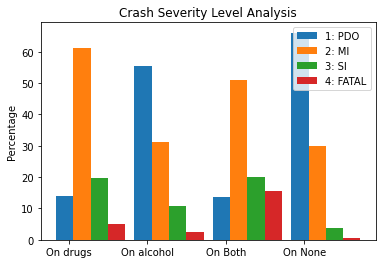

In [173]:
# Creating a bar graph for the visual representation of the data

import numpy as np
import matplotlib.pyplot as plt

N = 4
PDO = (14.09,55.43,13.71,66.06)
MI = (61.17,31.26,50.86,29.83)
SI= (19.65,10.81,20.0,3.65)
FATAL = (5.1,2.51,15.43,0.46)

ind = np.arange(N) 
width = 0.22      
plt.bar(ind, PDO, width, label='1: PDO')
plt.bar(ind + width , MI, width, label='2: MI')
plt.bar(ind + width*2, SI, width, label='3: SI')
plt.bar(ind + width*3, FATAL, width, label='4: FATAL')

plt.ylabel('Percentage')
plt.title('Crash Severity Level Analysis')

plt.xticks(ind + width / 4, ('On drugs','On alcohol','On Both','On None'))
plt.legend(loc='upper right')
#plt.savefig("Analysis.png")
plt.show()

### <p><strong style="color:red"> Inference : </strong>  
<p><strong style="color:#2a52be">
1. Fatality rate ↓ when the driver is under no influence of both drugs and alcohol.  
<p>2. Fatality rate ↑ when the driver is under the influence of both drugs and alcohol.
<p>3. Minor Injuries ↑ with the influence of drugs.  
<p>4. Property damage is seen to be the most when under no influence of drugs and alcohol.
</strong> 

## 2.4 RDDs vs DataFrame vs Spark SQL

#### 1. Find the Date and Time of Crash, Number of Casualties in each unit and the Gender, Age, License Type of the unit driver for the suburb "Adelaide".


### <b><u>Using RDD</u></b>

In [174]:
%%time

#Filter the blanks and XXX unwarranted fields from the age field
adelaideUnitRDD = unitsRDD.filter(lambda x: x[8] != "")
adelaideUnitRDD = adelaideUnitRDD.filter(lambda x: x[8] != 'XXX')
# Creating a key value pair with key as REPORT_ID and values as total casualities, Sex, Age, Licence Type 
adelaideUnitRDD = adelaideUnitRDD.map(lambda x: (x[0], (x[1],x[2],x[7],x[8],x[11])))
adelaideUnitRDD.take(5)
#Filtering the data to get only the Suburb details of Adelaide
adelaideCrashRDD = crashRDD.filter(lambda x: x[2] == "ADELAIDE")
# Create a key value pair with key as REPORT_ID and values as date in the form of (Year-Month-Dayofweek)
adelaideCrashRDD = adelaideCrashRDD.map(lambda x: (x[0], (x[10]+"-" +x[11]+ "-" +x[12], x[13])))
adelaideCrashRDD.take(5)
# Joining the two RDD's to get the set of all fields
adelaideJoinedRDD = adelaideCrashRDD.join(adelaideUnitRDD)
adelaideJoinedRDD.collect()
#Creating a key value pair, with the unit no as key and the other fields as values.
adelaideJoinedRDD = adelaideJoinedRDD.map(lambda x : (x[1][1][0] , (x[1][0][0], x[1][0][1], x[1][1][2],int(x[1][1][3]),x[1][1][4]))) 
#Grouping by key to get all the records for a unit no in a list
adelaideGroupedRDD = adelaideJoinedRDD.groupByKey().map(lambda x : (x[0], list(x[1])))
#Displaying the results
adelaideGroupedRDD.collect()


CPU times: user 81.2 ms, sys: 20.7 ms, total: 102 ms
Wall time: 4.86 s


[('01',
  [('2019-January-Friday', '12:10 am', 'Male', 36, 'Full'),
   ('2019-January-Thursday', '12:15 pm', 'Male', 22, 'Full'),
   ('2019-January-Friday', '01:00 pm', 'Female', 21, 'Full'),
   ('2019-January-Thursday', '03:00 pm', 'Female', 61, 'Full'),
   ('2019-January-Saturday', '01:50 pm', 'Female', 39, 'Full'),
   ('2019-January-Thursday', '12:55 pm', 'Male', 19, 'Full'),
   ('2019-January-Monday', '02:16 pm', 'Male', 64, ''),
   ('2019-January-Wednesday', '02:47 pm', 'Male', 44, 'Full'),
   ('2019-February-Wednesday', '06:40 pm', 'Male', 51, 'Full'),
   ('2019-February-Friday', '07:55 am', 'Female', 43, 'Full'),
   ('2019-February-Saturday', '10:30 am', 'Male', 27, 'Full'),
   ('2019-March-Monday', '09:55 am', 'Female', 23, 'Full'),
   ('2019-March-Wednesday', '05:27 pm', 'Female', 35, 'Full'),
   ('2019-March-Tuesday', '06:16 pm', 'Female', 29, 'Full'),
   ('2019-April-Monday', '09:50 am', 'Female', 22, 'Full'),
   ('2019-April-Friday', '03:13 pm', 'Male', 20, 'Learners'),
   

### <b><u>Using DataFrame</u></b>

In [175]:
%%time

#Cleaning and filtering the Age column to integer values without empty or 'XXX' characters
unitDF = unitDF.filter(unitDF["Age"] != "")
unitDF = unitDF.filter(unitDF["Age"] != "XXX")

crashfilterDF =  crashDF.filter(crashDF["Suburb"] == "ADELAIDE")

unitDF = unitDF.select("Unit No","Sex", "Age", "Licence Type" ,"REPORT_ID")
crashfilterDF = crashfilterDF.select("Total Cas", "Time", "Year","Month","Day","REPORT_ID")

# Joining the two dataframes to get the set of all fields
crashJoinUnitsDF = crashfilterDF.join(unitDF, crashfilterDF["REPORT_ID"] == unitDF["REPORT_ID"])

#Creating a date column in the form of (Year-Month-Dayofweek)
crashUnitsAdelaideDF = crashJoinUnitsDF.withColumn("Date", f.concat(f.col("Year"),f.lit('-'),f.col("Month"),f.lit('-'),f.col("Day")))

#Displaying the final set of records
crashUnitsAdelaideDF.select("Unit No","Date", "Time", "Total Cas", "Sex", "Age", "Licence Type").show(truncate = False)


+-------+-----------------------+--------+---------+------+---+------------+
|Unit No|Date                   |Time    |Total Cas|Sex   |Age|Licence Type|
+-------+-----------------------+--------+---------+------+---+------------+
|1      |2016-November-Wednesday|01:45 pm|1        |Male  |056|Full        |
|2      |2016-November-Wednesday|01:45 pm|1        |Male  |072|null        |
|1      |2016-November-Tuesday  |03:40 pm|1        |Male  |056|null        |
|2      |2016-November-Tuesday  |03:40 pm|1        |Female|027|null        |
|1      |2016-November-Tuesday  |05:00 pm|0        |Female|032|Full        |
|1      |2016-November-Tuesday  |05:40 pm|0        |Male  |022|Unknown     |
|2      |2016-November-Tuesday  |05:40 pm|0        |Male  |020|Unknown     |
|2      |2016-November-Monday   |11:26 pm|0        |Male  |042|Full        |
|1      |2016-November-Monday   |11:30 pm|0        |Male  |026|Unknown     |
|2      |2016-November-Monday   |11:30 pm|0        |Male  |038|Full        |

### <b><u>Using SQL</u></b>

In [176]:
#Creating SQL Temporary tables from the dataframes

crashDF.registerTempTable("crashTb")
unitDF.registerTempTable("unitsTb")


In [177]:
%%time
#Running the SQL query by joining the two table Crash and Units
query = "SELECT u.`Unit No`,CONCAT(c.Year, '-',  c.Month, '-', c.Day) as Date, c.Time, c.`Total Cas`, u.Sex, u.Age ,u.`Licence Type`FROM crashTb c INNER JOIN unitsTb u ON c.REPORT_ID = u.REPORT_ID WHERE c.Suburb = 'ADELAIDE'"
output = spark.sql(query)

#Displaying the results for the query
output.show(20, False)


+-------+-----------------------+--------+---------+------+---+------------+
|Unit No|Date                   |Time    |Total Cas|Sex   |Age|Licence Type|
+-------+-----------------------+--------+---------+------+---+------------+
|1      |2016-November-Wednesday|01:45 pm|1        |Male  |056|Full        |
|2      |2016-November-Wednesday|01:45 pm|1        |Male  |072|null        |
|1      |2016-November-Tuesday  |03:40 pm|1        |Male  |056|null        |
|2      |2016-November-Tuesday  |03:40 pm|1        |Female|027|null        |
|1      |2016-November-Tuesday  |05:00 pm|0        |Female|032|Full        |
|1      |2016-November-Tuesday  |05:40 pm|0        |Male  |022|Unknown     |
|2      |2016-November-Tuesday  |05:40 pm|0        |Male  |020|Unknown     |
|2      |2016-November-Monday   |11:26 pm|0        |Male  |042|Full        |
|1      |2016-November-Monday   |11:30 pm|0        |Male  |026|Unknown     |
|2      |2016-November-Monday   |11:30 pm|0        |Male  |038|Full        |

### 2. Find the total number of casualties for each suburb when the vehicle was driven by an unlicensed driver. You are required to display the name of the suburb and the total number of casualties.



### <b><u>Using RDD</u></b>

In [178]:
%%time

#Filtering the units RDD with drivers record for Unlicenced Licence Type
unlicensedDriverRDD = unitsRDD.filter(lambda x: x[11] == "Unlicenced")

#Creating a key value pair for REPORT_ID as the key and Licence Type as the value
unlicensedDriverRDD = unlicensedDriverRDD.map(lambda x: (x[0], x[11]))

#Creating a key value pair for REPORT_ID as the key and Total casuality and the Suburb as values
crashedDriverRDD = crashRDD.map(lambda x: (x[0],(x[6],x[2])))

#Joining the two key value paired RDD on REPORT_ID
allDetailsRDD = crashedDriverRDD.join(unlicensedDriverRDD)

#Creating a key value pair for Surburb and total Casualities as the value 
suburbCasualityRDD = allDetailsRDD.map(lambda x: (x[1][0][1], int(x[1][0][0])))

#Summing the total no of casualities in a suburb
suburbCasualityRDD = suburbCasualityRDD.reduceByKey(lambda x,y: (x+y))

#Sorting the records with the most total no of casualities shown first
suburbCasualityRDD = suburbCasualityRDD.sortBy(lambda x: x[1], ascending = False)

#Displaying the final set of records in the rdd
suburbCasualityRDD.collect()

CPU times: user 79.7 ms, sys: 4.41 ms, total: 84.1 ms
Wall time: 4.01 s


[('ADELAIDE', 19),
 ('DRY CREEK', 18),
 ('SALISBURY', 18),
 ('SALISBURY EAST', 16),
 ('PROSPECT', 14),
 ('NORTH ADELAIDE', 13),
 ('ANDREWS FARM', 12),
 ('ENFIELD', 12),
 ('INGLE FARM', 11),
 ('SALISBURY SOUTH', 11),
 ('BEDFORD PARK', 11),
 ('SALISBURY DOWNS', 11),
 ('MAWSON LAKES', 10),
 ('MUNNO PARA', 10),
 ('BURTON', 10),
 ('MOUNT BARKER', 10),
 ('ELIZABETH PARK', 10),
 ('MORPHETT VALE', 10),
 ('SALISBURY PLAIN', 10),
 ('PLYMPTON', 9),
 ('ELIZABETH EAST', 9),
 ('PARA HILLS WEST', 9),
 ('SALISBURY NORTH', 9),
 ('HOLDEN HILL', 9),
 ('ELIZABETH GROVE', 9),
 ('DAVOREN PARK', 8),
 ('MOUNT GAMBIER', 8),
 ('SEATON', 8),
 ('ELIZABETH SOUTH', 8),
 ('FLINDERS PARK', 8),
 ('SOUTH PLYMPTON', 8),
 ('ONKAPARINGA HILLS', 7),
 ('COOBER PEDY', 7),
 ('KANGARILLA', 7),
 ('PARAFIELD GARDENS', 7),
 ('MURRAY BRIDGE', 7),
 ('MAGILL', 7),
 ('GILLES PLAINS', 7),
 ('BROOKLYN PARK', 7),
 ('WHYALLA NORRIE', 7),
 ('BURRA', 7),
 ('WINGFIELD', 6),
 ('HACKHAM WEST', 6),
 ('EDWARDSTOWN', 6),
 ('ROSEWORTHY', 6),
 ('F

### <b><u> Using Data Frame </u></b>

In [179]:
#from pyspark.sql.types import *

%time
#Filtering the units DF with drivers record for Unlicenced Licence Type
unlicencedDriverDF = unitDF.filter(unitDF["Licence Type"] == "Unlicenced")

#Selecting the required columns from the filtered Units Data Frame 
unlicencedDriverDF = unlicencedDriverDF.select("REPORT_ID", "Licence Type")

#Selecting the required columns from the filtered Crash Data Frame
suburbCrashDF = crashDF.select("REPORT_ID", "Suburb", "Total Cas")

#Converting/casting the string type of data to Int for Summing
suburbCrashDF = suburbCrashDF.withColumn("Total Cas",f.col("Total Cas").cast("Int"))

#Joining the two filtered data frames on REPORT_ID
suburbJoinDF = unlicencedDriverDF.join(suburbCrashDF, on="REPORT_ID")

#Grouping the joined data and summing the total casualities on the grouped data
suburbCountDF = suburbJoinDF.groupBy("Suburb").sum()

#Renaming the aggregated grouped column and sorting it with the highest no of casualities shown first
suburbCountDF.withColumnRenamed("sum(Total Cas)", "Total No of Casualities").sort(f.col("Total No of Casualities").desc()).show()

CPU times: user 4 µs, sys: 0 ns, total: 4 µs
Wall time: 8.11 µs
+---------------+-----------------------+
|         Suburb|Total No of Casualities|
+---------------+-----------------------+
|       ADELAIDE|                     19|
|      SALISBURY|                     18|
|      DRY CREEK|                     17|
| SALISBURY EAST|                     16|
|       PROSPECT|                     14|
| NORTH ADELAIDE|                     13|
|   ANDREWS FARM|                     12|
|        ENFIELD|                     12|
|     INGLE FARM|                     11|
|SALISBURY DOWNS|                     11|
|   BEDFORD PARK|                     11|
|SALISBURY SOUTH|                     11|
|SALISBURY PLAIN|                     10|
|   MOUNT BARKER|                     10|
|     MUNNO PARA|                     10|
|  MORPHETT VALE|                     10|
|         BURTON|                     10|
|   MAWSON LAKES|                     10|
| ELIZABETH EAST|                      9|
|SALISBURY N

### <b><u> Using SQL </u></b>

In [180]:
%%time
#Creating the SQL query by joining the data

query = "SELECT c.Suburb, floor(SUM(c.`Total Cas`)) AS `Total No of Casualities` FROM crashTb c INNER JOIN unitsTb u ON c.Report_ID = u.Report_ID WHERE u.`Licence Type` == 'Unlicenced' GROUP BY c.Suburb ORDER BY sum(c.`Total Cas`) desc"
output = spark.sql(query)
output.show(20,False)

+---------------+-----------------------+
|Suburb         |Total No of Casualities|
+---------------+-----------------------+
|ADELAIDE       |19                     |
|SALISBURY      |18                     |
|DRY CREEK      |17                     |
|SALISBURY EAST |16                     |
|PROSPECT       |14                     |
|NORTH ADELAIDE |13                     |
|ENFIELD        |12                     |
|ANDREWS FARM   |12                     |
|INGLE FARM     |11                     |
|SALISBURY DOWNS|11                     |
|SALISBURY SOUTH|11                     |
|BEDFORD PARK   |11                     |
|SALISBURY PLAIN|10                     |
|MUNNO PARA     |10                     |
|MOUNT BARKER   |10                     |
|MORPHETT VALE  |10                     |
|BURTON         |10                     |
|MAWSON LAKES   |10                     |
|ELIZABETH GROVE|9                      |
|ELIZABETH EAST |9                      |
+---------------+-----------------

<b><p> <strong style="color:red"> Analysis based on the Performance Runtime: </b> </strong>
<strong style="color:#2a52be">
<p> 1. The overall time taken for data frame operations were comparatively lesser than RDDs and SQL.
<p> 2. For the operations involving the use of group by and sorting it was seen that  data frames performed significantly better than the others.
<p> 3. SQL Queries and Data Frames comparatively took the same execution time for queries involving joins and filtering. 
<p> 4. RDD uses Java Serialization, whenever the data needs to be distributed within the cluster or written to the disk, where as in data frame there is no need for encoding as data frames are schema based. Hence, is much slower.
<p> 5. Another major drawback is that RDDs have no inbuilt optimization engine, whereas data frames do. 
<p> 6. Data frames on an average are a better option for complex queries and use cases. Because of the different data frames APIs available and the constant development in the community.

</strong>